# 1. Load checkpoints

In [1]:
from transformers import AutoProcessor, AutoModelForVision2Seq
from qwen_vl_utils import process_vision_info
import warnings
import torch
warnings.filterwarnings("ignore", category=FutureWarning, module="transformers")
import os 

model_path = "Qwen/Qwen3-VL-4B-Instruct"
processor = AutoProcessor.from_pretrained(model_path)

device = "cuda:0"

model, output_loading_info = AutoModelForVision2Seq.from_pretrained(model_path, 
                                                                    torch_dtype=torch.bfloat16 if torch.cuda.is_available() else torch.float32, 
                                                                    device_map=device, 
                                                                    attn_implementation="flash_attention_2", # or "sdpa"
                                                                    output_loading_info=True)
print("output_loading_info", output_loading_info)

model.eval()
print("Model loaded successfully!")

`torch_dtype` is deprecated! Use `dtype` instead!


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

output_loading_info {'missing_keys': [], 'unexpected_keys': [], 'mismatched_keys': [], 'error_msgs': []}
Model loaded successfully!


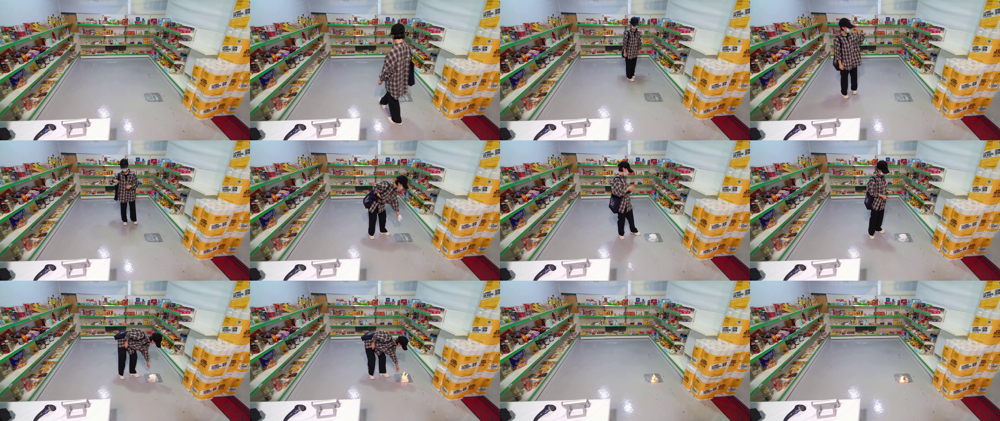

In [2]:
from utils import create_image_grid
import os

image_folder = "./samples/C_AF_1"
video_frame_list = sorted(
    [os.path.join(image_folder, f) for f in os.listdir(image_folder) if f.endswith(".jpg")], 
    key=lambda x: int(os.path.basename(x).split('.')[0])
)

prompt = "What happened in the video? Explain in what happend by frame number"

# Visualize the video frames in a grid
create_image_grid(video_frame_list, num_columns=4)

# 2. Demo

## 2.1. Video processing

In [ ]:
from qwen_vl_utils import process_vision_info
from IPython.display import Markdown, display

messages = [
    {"role": "user", "content": [
            {"video": video_frame_list,
            "total_pixels": 20480 * 32 * 32, 
            "min_pixels": 64 * 32 * 32, 
            "max_frames": 2048,
            'sample_fps':1},
            {"type": "text", "text": prompt},
        ]
    },
]

text = processor.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)
image_inputs, video_inputs, video_kwargs = process_vision_info([messages], return_video_kwargs=True, 
                                                                   image_patch_size= 16,
                                                                   return_video_metadata=True)

if video_inputs is not None:
        video_inputs, video_metadatas = zip(*video_inputs)
        video_inputs, video_metadatas = list(video_inputs), list(video_metadatas)
else:
    video_metadatas = None

inputs = processor(text=[text], images=image_inputs, videos=video_inputs, video_metadata=video_metadatas, **video_kwargs, do_resize=False, return_tensors="pt")
inputs = inputs.to(device)

output_ids = model.generate(**inputs, max_new_tokens=1024, do_sample=False)
generated_ids = [output_ids[len(input_ids):] for input_ids, output_ids in zip(inputs.input_ids, output_ids)]
output_text = processor.batch_decode(generated_ids, skip_special_tokens=True, clean_up_tokenization_spaces=True)

display(Markdown(output_text[0]))

The following generation flags are not valid and may be ignored: ['temperature', 'top_p', 'top_k']. Set `TRANSFORMERS_VERBOSITY=info` for more details.


In frame 0, the video opens with a wide shot of a small, well-lit convenience store. The shelves are stocked with various products, including snacks, beverages, and household items. On the right side, there is a large stack of toilet paper rolls. The floor is clean and shiny, and a small metallic sheet is placed on the floor near the center. In the foreground, there is a checkout counter with a scanner and a cash register.

In frame 1, a person enters the store from the left side. They are wearing a plaid shirt, black pants, white shoes, and a black cap. They are carrying a black bag over their shoulder. The person walks towards the center of the store, approaching the metallic sheet on the floor.

In frame 2, the person stops near the metallic sheet and looks down at it. They appear to be examining it or preparing to interact with it. Their posture suggests curiosity or intent.

In frame 3, the person bends down and reaches towards the metallic sheet. They seem to be picking up or manipulating something on the sheet. Their movements are deliberate, indicating they are focused on the task.

In frame 4, the person is now holding a small object in their hand. They are still bent over the metallic sheet, and their attention is on the object they are holding. The object appears to be a small, white, fluffy item, possibly a piece of cotton or a similar material.

In frame 5, the person places the white fluffy object on the metallic sheet. They then stand up and step back slightly, observing the object as it begins to burn. The flames are small and flicker, indicating that the object is igniting.

In frame 6, the person steps back further, watching the flames as they grow slightly larger. The flames are now more visible, and the person appears to be observing the burning object with interest.

In frame 7, the person continues to stand back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 8, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 9, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 10, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 11, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 12, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 13, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 14, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 15, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 16, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 17, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 18, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 19, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 20, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 21, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 22, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 23, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 24, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 25, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 26, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 27, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 28, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 29, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 30, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 31, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 32, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 33, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 34, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 35, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 36, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 37, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 38, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 39, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 40, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 41, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 42, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 43, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 44, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 45, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 46, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 47, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 48, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 49, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 50, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 51, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 52, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 53, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 54, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 55, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 56, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 57, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 58, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 59, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 60, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 61, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 62, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 63, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 64, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 65, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 66, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 67, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 68, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 69, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 70, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 71, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 72, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 73, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 74, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 75, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 76, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 77, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 78, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 79, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 80, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 81, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 82, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 83, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 84, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 85, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 86, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 87, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 88, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 89, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 90, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 91, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 92, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 93, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 94, the person is still standing back, watching the flames. The flames are now more intense, and the person seems to be observing the burning object with a sense of curiosity or fascination.

In frame 95, the person is still standing back, watching the flames. The

## 2.2 Multi-image processing

In [3]:
from qwen_vl_utils import process_vision_info
from IPython.display import Markdown, display

content = [{"type": "image", "image": im} for im in video_frame_list]
content.append({"type": "text", "text": prompt})

messages = [
    {"role": "user", "content": content}
]

text = processor.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)
image_inputs, video_inputs, video_kwargs = process_vision_info([messages], return_video_kwargs=True, 
                                                                   image_patch_size= 16,
                                                                   return_video_metadata=True)

inputs = processor(text=[text], images=image_inputs, return_tensors="pt")
inputs = inputs.to(device)

output_ids = model.generate(**inputs, max_new_tokens=1024, do_sample=False)
generated_ids = [output_ids[len(input_ids):] for input_ids, output_ids in zip(inputs.input_ids, output_ids)]
output_text = processor.batch_decode(generated_ids, skip_special_tokens=True, clean_up_tokenization_spaces=True)

display(Markdown(output_text[0]))

The following generation flags are not valid and may be ignored: ['temperature', 'top_p', 'top_k']. Set `TRANSFORMERS_VERBOSITY=info` for more details.


Here is a step-by-step explanation of what happened in the video, based on the sequence of frames:

1.  **Frame 0:** The video opens with a static shot of an empty convenience store aisle. The shelves are stocked with various products, and a large stack of toilet paper is visible on the right. A small, crumpled piece of foil lies on the floor in the center of the aisle.

2.  **Frame 1:** A person enters the frame from the right side of the screen. They are wearing a plaid shirt, black pants, a black cap, and a face mask. They walk towards the center of the aisle.

3.  **Frame 2:** The person stops in the middle of the aisle, facing the camera. They appear to be looking around or observing the store.

4.  **Frame 3:** The person adjusts their cap with their right hand, then looks down at the foil on the floor.

5.  **Frame 4:** The person reaches into their left shoulder bag and pulls out a small, white, fluffy object, which appears to be a piece of cotton or a similar material.

6.  **Frame 5:** The person bends down and places the white fluffy object onto the crumpled foil on the floor.

7.  **Frame 6:** The person stands up, looks at the object on the floor, and then reaches into their bag again, pulling out a small, thin object that looks like a lighter or a match.

8.  **Frame 7:** The person holds the lighter and looks down at the object on the floor.

9.  **Frame 8:** The person bends down again and uses the lighter to ignite the white fluffy object on the foil. A small flame appears.

10. **Frame 9:** The flame grows slightly, and the person steps back, watching the fire.

11. **Frame 10:** The fire continues to burn steadily on the foil. The person is no longer in the frame.

In summary, the video shows a person entering a store, approaching a piece of foil on the floor, placing a fluffy white object on it, and then igniting it with a lighter, causing a small fire to start.

## 2.3 Multi-image w/frame-index processing

In [4]:
from qwen_vl_utils import process_vision_info
from IPython.display import Markdown, display

content = []
sample_fps = 1
for frame_num, im in enumerate(video_frame_list):
    time_val = frame_num / sample_fps
    # content.append({"type": "text", "text": f"<{time_val:.1f} seconds>"})
    content.append({"type": "text", "text": f"<frame {frame_num+1}>"})
    content.append({"type": "image", "image": im})
content.append({"type": "text", "text": prompt})
messages = [
    {"role": "user", "content": content}
]

text = processor.apply_chat_template(messages, tokenize=False, add_generation_prompt=True)
image_inputs, video_inputs, video_kwargs = process_vision_info([messages], return_video_kwargs=True, 
                                                                   image_patch_size= 16,
                                                                   return_video_metadata=True)

inputs = processor(text=[text], images=image_inputs, return_tensors="pt")
inputs = inputs.to(device)

output_ids = model.generate(**inputs, max_new_tokens=1024, do_sample=False)
generated_ids = [output_ids[len(input_ids):] for input_ids, output_ids in zip(inputs.input_ids, output_ids)]
output_text = processor.batch_decode(generated_ids, skip_special_tokens=True, clean_up_tokenization_spaces=True)

display(Markdown(output_text[0]))

In frame 1, the video shows the interior of a small convenience store with shelves stocked with various products, including snacks, beverages, and household items. The floor is clean and shiny, and there is a cash register on the counter in the foreground. A small piece of foil is lying on the floor near the center.

In frame 2, a person wearing a plaid shirt, black pants, and a black cap enters the store from the right side and walks toward the center of the room, passing by the shelves.

In frame 3, the person has stopped in the middle of the store, facing the shelves, and appears to be looking around or observing the store.

In frame 4, the person adjusts their cap with one hand while standing still, possibly preparing to do something.

In frame 5, the person begins to bend down toward the foil on the floor, reaching for it with their right hand.

In frame 6, the person is now holding a white object, which appears to be a piece of tissue or paper, and is in the process of placing it on the foil.

In frame 7, the person stands upright, holding the white object in their right hand, and looks at the foil on the floor.

In frame 8, the person bends down again, this time reaching toward the foil with their right hand, possibly to adjust or interact with the object on the floor.

In frame 9, the person is now bending over the foil, and a small flame is visible on the foil, indicating that the white object has been ignited.

In frame 10, the flame is now clearly visible and burning on the foil, with the person standing slightly back, observing the fire.

In frame 11, the person has moved out of the frame, leaving the flame burning on the foil in the center of the store.

In frame 12, the person is no longer visible, and the flame continues to burn on the foil, with the store remaining empty except for the burning object on the floor.

The video captures a person entering a convenience store, approaching a piece of foil on the floor, and igniting a white object on it, resulting in a small fire. The person then leaves the frame, leaving the fire burning on the floor.